In [ ]:
!sudo apt-get -qq  update && apt-get install ffmpeg libsm6 libxext6 -y


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
libsm6 is already the newest version (2:1.2.3-1build2).
libxext6 is already the newest version (2:1.3.4-1build1).
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 45 not upgraded.


In [ ]:
!pip3 install -q -U diffusers ftfy invisible_watermark accelerate transformers safetensors matplotlib scipy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 30.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 63.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 309.4/309.4 kB 37.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 83.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.6/38.6 MB 43.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 75.0 MB/s eta 0:00:00


In [ ]:
!pip3 install -q -U peft transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.6/251.6 kB 7.4 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%matplotlib inline

import numpy
import torch
import os
from PIL import Image
from matplotlib import pyplot as plt

from torch import autocast
from torchvision import transforms as tfms
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer, logging

from diffusers import (
    DiffusionPipeline,
    StableDiffusionPipeline,
    UNet2DConditionModel,
    )

logging.set_verbosity_error()

/usr/local/lib/python3.10/dist-packages/diffusers/models/transformers/transformer_2d.py:34: FutureWarning: `Transformer2DModelOutput` is deprecated and will be removed in version 1.0.0. Importing `Transformer2DModelOutput` from `diffusers.models.transformer_2d` is deprecated and this will be removed in a future version. Please use `from diffusers.models.modeling_outputs import Transformer2DModelOutput`, instead.
  deprecate("Transformer2DModelOutput", "1.0.0", deprecation_message)


In [ ]:
pipe = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16)
pipe.to("cuda")
pipe.load_lora_weights("/content/drive/MyDrive/IT/CV_OTUS/00_CW_Fashion_Diffusion/sdxl-fashion-lora/final")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

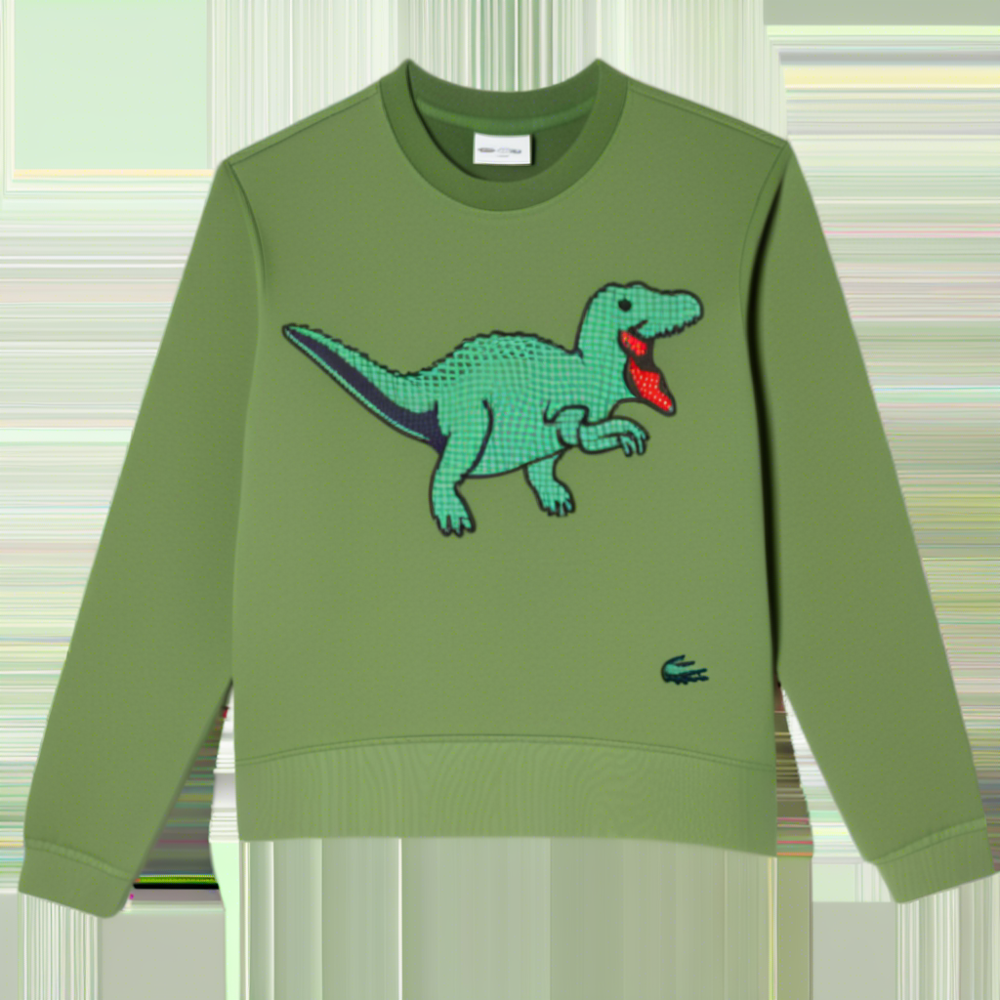

In [ ]:
prompt = "top, Lacoste Print Sweatshirt green, a photography of a green sweatshirt with dinosaur on it"

pipe_output = pipe(prompt, num_inference_steps=45, guidance_scale=7.5)

pipe_output.images[0]

# image.save("example.png")

In [ ]:
#set models paths
pretrained_model_id =  "stabilityai/stable-diffusion-xl-base-1.0"
lora_path = "/content/drive/MyDrive/IT/CV_OTUS/00_CW_Fashion_Diffusion/sdxl-fashion-lora/"

# Configuration
checkpoints = sorted([entry.name for entry in os.scandir(lora_path) if entry.is_dir()])
checkpoints.insert(0, None)
prompt = "top, Lacoste Print Sweatshirt green, a photography of a green sweatshirt with dinosaur on it"
negative_prompt = "Oversaturated, blurry, low quality"
height = 1024
width = 1024
guidance_scale = 7.5
num_inference_steps = 45
device = "cuda" if torch.cuda.is_available() else "cpu"

# Seed generator
generator = torch.manual_seed(42)

# Store generated images
images_ft = []
labels_ft  = []

for i, checkpoint in enumerate(checkpoints):
    if i == 0:
        pipe = DiffusionPipeline.from_pretrained(pretrained_model_id, torch_dtype=torch.float16)
        pipe.to(device)
    else:
        pipe = DiffusionPipeline.from_pretrained(pretrained_model_id, torch_dtype=torch.float16)
        pipe.to(device)
        pipe.load_lora_weights(lora_path+checkpoint)

    # Generate image
    pipe_output = pipe(
        prompt=prompt,
        negative_prompt=negative_prompt,
        height=height,
        width=width,
        guidance_scale=guidance_scale,
        num_inference_steps=num_inference_steps,
        generator=generator
    )

    # # Extract the image from the output tensor
    # image_tensor = pipe_output.images[0].cpu().numpy()
    # # Convert tensor to PIL image
    # image_pil = Image.fromarray((image_tensor * 255).astype(np.uint8))
    # # Resize the generated image before adding it to the list
    # resized_image = image_pil.resize((512, 512), Image.ANTIALIAS)

    image = pipe_output.images[0]

    # Collect the resized image
    images_ft.append(image)
    labels_ft.append(checkpoint if checkpoint is not None else "Initial Model")

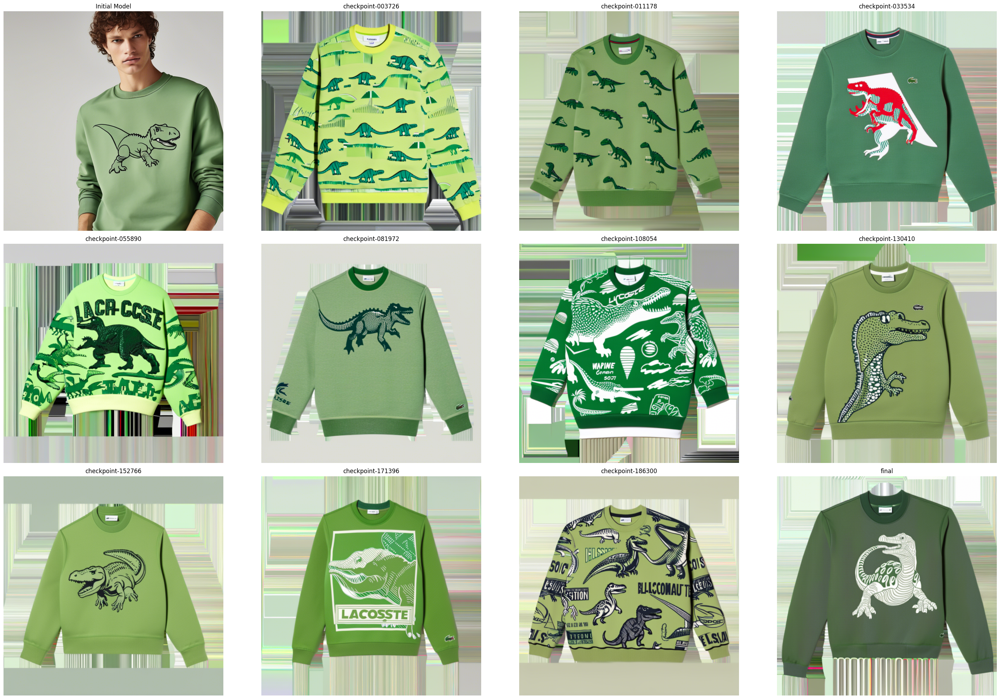

In [ ]:
# Plot the images with labels
fig, axes = plt.subplots(nrows=(len(images_ft) + 2) // 4, ncols=4, figsize=(30, 20))

for ax, image, label in zip(axes.flatten(), images_ft, labels_ft):
    ax.imshow(image)
    ax.set_title(label, fontsize=12)
    ax.axis('off')

# Adjust layout and show the plot
plt.tight_layout()

plt.savefig("images_lora_sdxl_dinozaur.png")

plt.show()

In [ ]:
prompts = [
    "bottom, IAB Studio x Stussy Green palms print Pink Shorts, a photography of Pink pants with a green palms print",
    "top, Lacoste Big Elephant Print Sweatshirt Green, a photography of a green sweatshirt with elephant on it",
    "bottom, Supreme Сhamomile Flower Print Baggy Jean Light Blue, a photography of a Light blue jean with an Сhamomile flower printing on",
]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

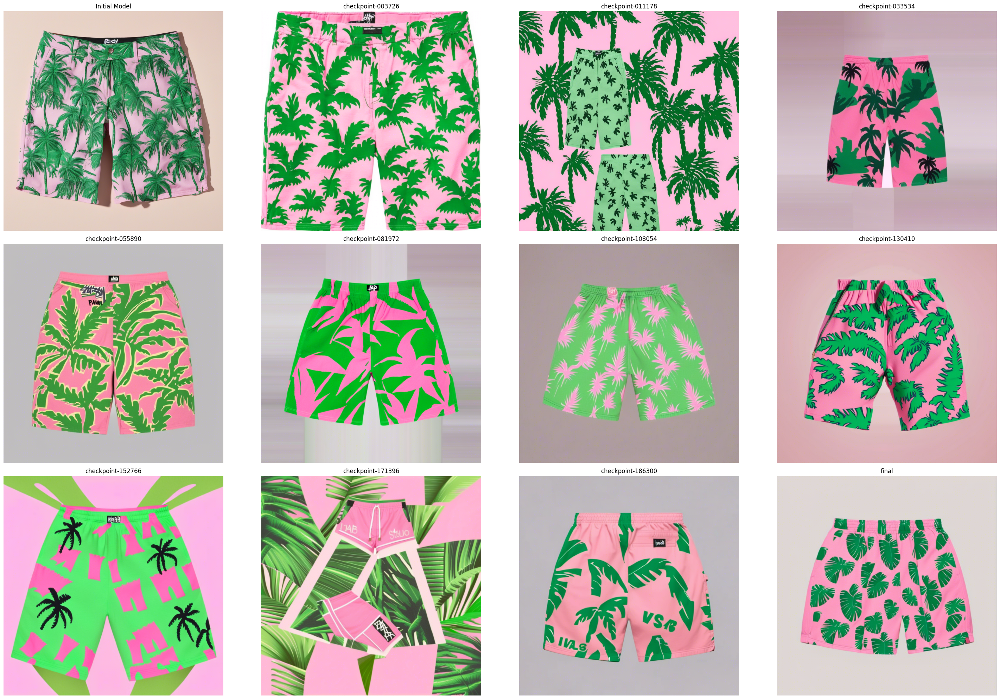

In [ ]:

negative_prompt = "Oversaturated, blurry, low quality"

# Store generated images
images_ft = []
labels_ft  = []

for i, checkpoint in enumerate(checkpoints):
    if i == 0:
        pipe = DiffusionPipeline.from_pretrained(pretrained_model_id, torch_dtype=torch.float16)
        pipe.to(device)
    else:
        pipe = DiffusionPipeline.from_pretrained(pretrained_model_id, torch_dtype=torch.float16)
        pipe.to(device)
        pipe.load_lora_weights(lora_path+checkpoint)

    # Generate image
    pipe_output = pipe(
        prompt=prompts[0],
        negative_prompt=negative_prompt,
        height=height,
        width=width,
        guidance_scale=guidance_scale,
        num_inference_steps=num_inference_steps,
        generator=generator
    )

    image = pipe_output.images[0]

    # Collect the resized image
    images_ft.append(image)
    labels_ft.append(checkpoint if checkpoint is not None else "Initial Model")


# Plot the images with labels
fig, axes = plt.subplots(nrows=(len(images_ft) + 2) // 4, ncols=4, figsize=(30, 20))

for ax, image, label in zip(axes.flatten(), images_ft, labels_ft):
    ax.imshow(image)
    ax.set_title(label, fontsize=12)
    ax.axis('off')

# Adjust layout and show the plot
plt.tight_layout()

plt.savefig("images_lora_sdxl_shorts.png")

plt.show()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/45 [00:00<?, ?it/s]

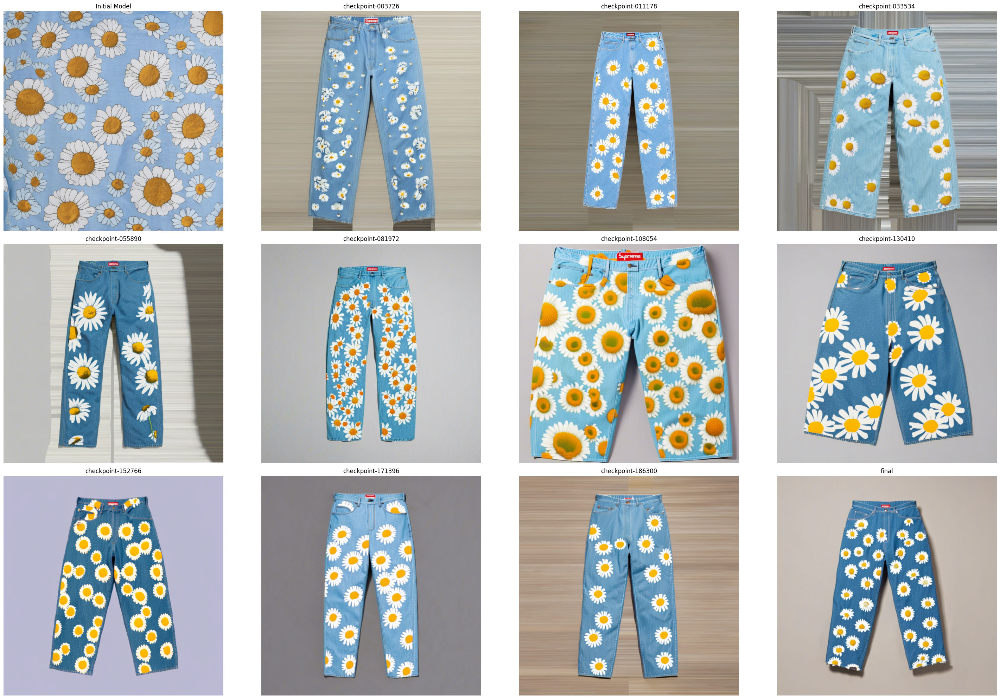

In [ ]:
negative_prompt = "Oversaturated, blurry, low quality"

# Store generated images
images_ft = []
labels_ft  = []

for i, checkpoint in enumerate(checkpoints):
    if i == 0:
        pipe = DiffusionPipeline.from_pretrained(pretrained_model_id, torch_dtype=torch.float16)
        pipe.to(device)
    else:
        pipe = DiffusionPipeline.from_pretrained(pretrained_model_id, torch_dtype=torch.float16)
        pipe.to(device)
        pipe.load_lora_weights(lora_path+checkpoint)

    # Generate image
    pipe_output = pipe(
        prompt=prompts[2],
        negative_prompt=negative_prompt,
        height=height,
        width=width,
        guidance_scale=guidance_scale,
        num_inference_steps=num_inference_steps,
        generator=generator
    )

    image = pipe_output.images[0]

    # Collect the resized image
    images_ft.append(image)
    labels_ft.append(checkpoint if checkpoint is not None else "Initial Model")


# Plot the images with labels
fig, axes = plt.subplots(nrows=(len(images_ft) + 2) // 4, ncols=4, figsize=(30, 20))

for ax, image, label in zip(axes.flatten(), images_ft, labels_ft):
    ax.imshow(image)
    ax.set_title(label, fontsize=12)
    ax.axis('off')

# Adjust layout and show the plot
plt.tight_layout()

plt.savefig("images_lora_sdxl_pants.png")

plt.show()